### Time Series Forecasting

In [1]:
# Importing required libraries
import pandas as pd
import numpy as np
import plotly.express as px
from datetime import datetime,timedelta
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt


# libraries for deep learning
import keras
from keras.layers import LSTM, Dense
from keras.models import Sequential

# checking if GPU is available for faster learning
import tensorflow as tf
print(tf.test.is_gpu_available())

Instructions for updating:
Use `tf.config.list_physical_devices('GPU')` instead.
True


#### Getting sense of our data

In [2]:
df=pd.read_csv('AssignmentData.csv')
df.head(96)

,Unnamed: 0,datetime,load,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover,date
0,0,2018-01-01 00:00:00,803.22270,10.458000,10.458000,0.955500,8.946000,0.000000,0.0,2018-01-01
1,1,2018-01-01 00:15:00,774.89523,10.326750,10.326750,0.961625,8.911875,0.000000,0.0,2018-01-01
2,2,2018-01-01 00:30:00,731.46927,10.195500,10.195500,0.967750,8.877750,0.000000,0.0,2018-01-01
3,3,2018-01-01 00:45:00,713.93870,10.064250,10.064250,0.973875,8.843625,0.000000,0.0,2018-01-01
4,4,2018-01-01 01:00:00,699.23007,9.933000,9.933000,0.980000,8.809500,0.000000,0.0,2018-01-01
...,...,...,...,...,...,...,...,...,...,...
91,91,2018-01-01 22:45:00,953.75007,11.591125,11.591125,1.015000,11.021500,0.422625,0.0,2018-01-01
92,92,2018-01-01 23:00:00,909.08383,11.448500,11.448500,1.022000,10.986500,0.483000,0.0,2018-01-01
93,93,2018-01-01 23:15:00,877.21833,11.305875,11.305875,1.029000,10.951500,0.543375,0.0,2018-01-01
94,94,2018-01-01 23:30:00,820.95527,11.163250,11.163250,1.036000,10.916500,0.603750,0.0,2018-01-01


In [3]:
df.describe()

,Unnamed: 0,load,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover
count,103584.000000,101952.000000,103584.000000,103584.000000,103584.000000,103584.000000,103584.000000,103584.000000
mean,51791.500000,1558.964330,29.084052,27.080153,0.602338,15.890729,2.431892,0.329437
std,29902.269479,531.116557,10.411410,8.496460,0.235395,7.938254,1.365737,0.334519
min,0.000000,480.631730,2.173500,3.685500,0.042000,-13.692000,0.000000,0.000000
25%,25895.750000,1184.992600,20.590500,20.559000,0.420000,9.783375,1.477875,0.000000
50%,51791.500000,1496.820000,29.922375,28.621688,0.609000,14.899500,2.352000,0.215250
75%,77687.250000,1935.745800,37.458750,33.348000,0.798000,23.887500,3.286500,0.582750
max,103583.000000,3230.848600,56.731500,47.943000,1.050000,31.059000,10.321500,1.050000


In [4]:
df.isnull().sum()

Unnamed: 0                 0
datetime                   0
load                    1632
apparent_temperature       0
temperature                0
humidity                   0
dew_point                  0
wind_speed                 0
cloud_cover                0
date                       0
dtype: int64

Looks like we have 10 features:<br>
Unnamed: 0 = row number<br>
datetime   = contains time stamps every for every 15 minutes interval<br>
date       = dates<br>
load       = our target variable<br>
rest variables are self explanatory<br><br>
load has total 1632 missing values which we will be imputing later

In [5]:
#setting datetime index
df['datetime']=pd.to_datetime(df['datetime'])
df.set_index(df['datetime'],inplace=True,drop=True)

In [6]:
# dropping columns which are not required
df.drop(['Unnamed: 0','datetime','date'],axis=1,inplace=True)

In [7]:
df.head()

,load,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover
datetime,,,,,,,
2018-01-01 00:00:00,803.22270,10.45800,10.45800,0.955500,8.946000,0.0,0.0
2018-01-01 00:15:00,774.89523,10.32675,10.32675,0.961625,8.911875,0.0,0.0
2018-01-01 00:30:00,731.46927,10.19550,10.19550,0.967750,8.877750,0.0,0.0
2018-01-01 00:45:00,713.93870,10.06425,10.06425,0.973875,8.843625,0.0,0.0
2018-01-01 01:00:00,699.23007,9.93300,9.93300,0.980000,8.809500,0.0,0.0


In [8]:
df.tail()

,load,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover
datetime,,,,,,,
2020-12-14 22:45:00,NaN,12.450375,12.450375,0.611625,4.087125,1.9110,0.0000
2020-12-14 23:00:00,NaN,12.285000,12.285000,0.619500,4.084500,1.8795,0.0000
2020-12-14 23:15:00,NaN,13.650000,13.650000,0.829500,8.589000,2.4675,0.8925
2020-12-14 23:30:00,NaN,13.650000,13.650000,0.829500,8.610000,2.4150,0.8925
2020-12-14 23:45:00,NaN,13.387500,13.387500,0.840000,8.662500,2.4150,0.8610


In [9]:
df.isnull().sum()

load                    1632
apparent_temperature       0
temperature                0
humidity                   0
dew_point                  0
wind_speed                 0
cloud_cover                0
dtype: int64

In [10]:
# creating a copy of load variable
df['load_copy']=df['load']

#### Understanding missing values

In [11]:
fig=px.line(df['load'])
fig.update_xaxes(rangeslider_visible=True)

#### Understanding missing data and how we will fill it:
Using slider to zoom into data, we can see that there are continues gaps in our data, also we can see that adjacent dates have very similar values. So we will impute our data with its adjacent day's value. For example if at [2020-12-11 00:15:00] load is null then we will impute it with previous day's value of load at [2020-12-19 00:15:00], but if value at previous day is also null then we will impute value of load from next day instead of previous, if this again fails then we will impute value from 2 days ago and 2 days later, we will fill values from upto 4 adjacent dates.

In [12]:
# loop to impute missing values
for i in range (1,5):
    df['load_shif']=df['load'].shift(4*24*i)
    for index in df.index:
        if np.isnan(df.loc[index]['load_copy'])==False:
            pass    
        else:
            df.loc[index]['load_copy']=df.loc[index]['load_shif']

    df['load_shif']=df['load'].shift(-4*24*i)
    for index in df.index:
        if np.isnan(df.loc[index]['load_copy'])==False:
            pass    
        else:
            df.loc[index]['load_copy']=df.loc[index]['load_shif']      

In [13]:
df.isnull().sum()

load                    1632
apparent_temperature       0
temperature                0
humidity                   0
dew_point                  0
wind_speed                 0
cloud_cover                0
load_copy                  0
load_shif               2016
dtype: int64

In [14]:
fig=px.line(df['load_copy'])
fig.update_xaxes(rangeslider_visible=True)

Using above plot and zooming in using slider we can see missing values imputed neatly.<br> But in the process we have also filled values for [2020-12-14] which we needed to predict, but this will not matter because our model will uses values for previous N days to predict value for N+1 day and after predicting values we will replace these imputed values to prediocted values.

In [15]:
# creating dataframe for feeding into model
df_input=df.drop(['load','load_shif'],axis=1)

In [16]:
df_input.head()

,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover,load_copy
datetime,,,,,,,
2018-01-01 00:00:00,10.45800,10.45800,0.955500,8.946000,0.0,0.0,803.22270
2018-01-01 00:15:00,10.32675,10.32675,0.961625,8.911875,0.0,0.0,774.89523
2018-01-01 00:30:00,10.19550,10.19550,0.967750,8.877750,0.0,0.0,731.46927
2018-01-01 00:45:00,10.06425,10.06425,0.973875,8.843625,0.0,0.0,713.93870
2018-01-01 01:00:00,9.93300,9.93300,0.980000,8.809500,0.0,0.0,699.23007


In [17]:
#### Since we are using LSTM as our predictor we will need to scale our data

In [18]:
#scaling the data
scaler=StandardScaler()
scaler=scaler.fit(df_input)
df_for_train=scaler.transform(df_input)

In [19]:
df_for_train=np.array(df_for_train)

In [20]:
#function to create training set
def df_to_X_y(df,window):
    X=[]
    y=[]
    for i in range(len(df)-window):
        row=[r for r in df[i:i+window]]
        X.append(row)
        y_row=df[i+window][6]
        y.append(y_row)
    return np.array(X),np.array(y)

In [21]:
df_for_train.shape

(103584, 7)

In [22]:
#splitting into train test sets
train=df_for_train[:100000]
test=df_for_train[100000:]

In [23]:
train_X,train_y=df_to_X_y(df=train,window=4*24*2)
test_X,test_y=df_to_X_y(df=test,window=4*24*2)

In [24]:
train_X.shape,train_y.shape

((99808, 192, 7), (99808,))

In [25]:
#Building model
model=Sequential()
model.add(LSTM(64,'tanh',input_shape=(train_X.shape[1],train_X.shape[2])))
model.add(Dense(8,'sigmoid'))
model.add(Dense(1,'linear'))
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 64)                18432     
                                                                 
 dense (Dense)               (None, 8)                 520       
                                                                 
 dense_1 (Dense)             (None, 1)                 9         
                                                                 
Total params: 18,961
Trainable params: 18,961
Non-trainable params: 0
_________________________________________________________________


In [26]:
model.compile(loss='mse')

In [27]:
model.fit(train_X,train_y,validation_split=0.1,epochs=5,verbose=1)

Epoch 1/5
2808/2808 [==============================] - 85s 28ms/step - loss: 0.0136 - val_loss: 0.0047
Epoch 2/5
2808/2808 [==============================] - 78s 28ms/step - loss: 0.0019 - val_loss: 0.0019
Epoch 3/5
2808/2808 [==============================] - 79s 28ms/step - loss: 0.0017 - val_loss: 0.0023
Epoch 4/5
2808/2808 [==============================] - 79s 28ms/step - loss: 0.0016 - val_loss: 0.0023
Epoch 5/5
2808/2808 [==============================] - 83s 29ms/step - loss: 0.0015 - val_loss: 0.0018


In [28]:
train_loss = model.evaluate(train_X, train_y, verbose=0)

In [29]:
test_loss = model.evaluate(test_X, test_y, verbose=0)

In [30]:
train_loss

0.0028678476810455322

In [31]:
test_loss

0.004183541052043438

#### Ploting predicted vs actual values for test set

In [32]:
# predicting values for test set
test_pred=model.predict(test_X)

Text(0.5, 1.0, 'actual values')

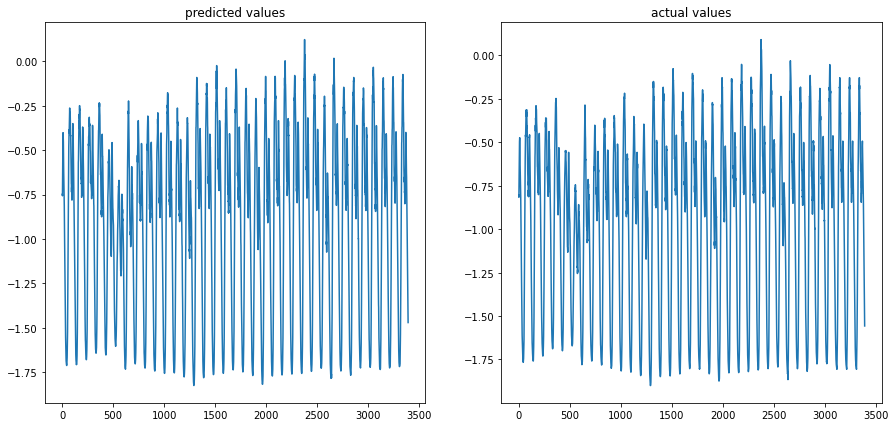

In [33]:
# plotting result
fig,a=plt.subplots(1,2,figsize=(15,7))
plt.sca(a[0])
plt.plot(test_pred)
plt.title('predicted values')
plt.sca(a[1])
plt.plot(test_y)
plt.title('actual values')

In [34]:
# function to create extract X values for to predict next load value
def x_for_last2days(date):
    date1=str(datetime.strptime(date, '%Y-%m-%d')-timedelta(2))[:-9]
    window=4*24*2
    d=date[:-2]
    p_day=int(date[-2:])-2
    df=df_input[date1:'{}'.format(date)]
    df=scaler.transform(df)
    X=[]
    for i in range(len(df)-window):
        row=[r for r in df[i:i+window]]
        X.append(row)
    return np.array(X)

In [35]:
#transfrorming to original values
def scaleback (data):
    val=np.repeat(data,len(df_input.columns),axis=-1)
    val=pd.DataFrame(scaler.inverse_transform(val))
    val.columns=df_input.columns
    val=val['load_copy']
    return val

#### Let us see for which dates we have to predict load

In [36]:
#index with missing load values
ind=df.index[df['load'].isna()==True]
#dates with missing load
indices=[]
for index in range(len(ind)):
    i=str(ind[index])[:-9]
    indices.append(i)
    dates_load_na=sorted(list(set(indices)))
dates_load_na

['2019-05-16',
 '2019-05-17',
 '2019-05-18',
 '2019-05-19',
 '2019-07-15',
 '2019-07-16',
 '2019-07-17',
 '2019-07-18',
 '2019-10-27',
 '2019-12-31',
 '2020-01-01',
 '2020-03-22',
 '2020-10-05',
 '2020-10-06',
 '2020-10-07',
 '2020-12-13',
 '2020-12-14']

In [37]:
print(len(dates_load_na)*24*4)

1632


Above value matches number of missing values in original load column in dataset

#### Now we will fill predited values for null values in each date mentioned above 

In [38]:
for i in range(len(dates_load_na)):
    x=x_for_last2days(dates_load_na[i])
    y=model.predict(x)
    scaled_value=scaleback(y)
    predicted_load=pd.DataFrame(scaled_value)
    for n in range(96):
        loc=df.index.get_loc(dates_load_na[i]+' 00:00:00')
        df.iloc[df.index.get_loc(dates_load_na[i]+' 00:00:00')+n]['load_copy']=predicted_load['load_copy'][n]


In [39]:
df.tail()

,load,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover,load_copy,load_shif
datetime,,,,,,,,,
2020-12-14 22:45:00,NaN,12.450375,12.450375,0.611625,4.087125,1.9110,0.0000,894.442444,NaN
2020-12-14 23:00:00,NaN,12.285000,12.285000,0.619500,4.084500,1.8795,0.0000,858.512329,NaN
2020-12-14 23:15:00,NaN,13.650000,13.650000,0.829500,8.589000,2.4675,0.8925,831.787598,NaN
2020-12-14 23:30:00,NaN,13.650000,13.650000,0.829500,8.610000,2.4150,0.8925,808.470947,NaN
2020-12-14 23:45:00,NaN,13.387500,13.387500,0.840000,8.662500,2.4150,0.8610,779.884827,NaN


In [40]:
#imputing prediction values where load is equal to null
for i in range(len(df)):
    if np.isnan(df.iloc[i]['load'])==True:
        df.iloc[i]['load']=df.iloc[i]['load_copy']
    else:
        pass

In [41]:
df.tail()

,load,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover,load_copy,load_shif
datetime,,,,,,,,,
2020-12-14 22:45:00,894.442444,12.450375,12.450375,0.611625,4.087125,1.9110,0.0000,894.442444,NaN
2020-12-14 23:00:00,858.512329,12.285000,12.285000,0.619500,4.084500,1.8795,0.0000,858.512329,NaN
2020-12-14 23:15:00,831.787598,13.650000,13.650000,0.829500,8.589000,2.4675,0.8925,831.787598,NaN
2020-12-14 23:30:00,808.470947,13.650000,13.650000,0.829500,8.610000,2.4150,0.8925,808.470947,NaN
2020-12-14 23:45:00,779.884827,13.387500,13.387500,0.840000,8.662500,2.4150,0.8610,779.884827,NaN


In [42]:
df_final=df.drop(['load_copy','load_shif'],axis=1)

In [43]:
df_final.tail()

,load,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover
datetime,,,,,,,
2020-12-14 22:45:00,894.442444,12.450375,12.450375,0.611625,4.087125,1.9110,0.0000
2020-12-14 23:00:00,858.512329,12.285000,12.285000,0.619500,4.084500,1.8795,0.0000
2020-12-14 23:15:00,831.787598,13.650000,13.650000,0.829500,8.589000,2.4675,0.8925
2020-12-14 23:30:00,808.470947,13.650000,13.650000,0.829500,8.610000,2.4150,0.8925
2020-12-14 23:45:00,779.884827,13.387500,13.387500,0.840000,8.662500,2.4150,0.8610


In [44]:
df_final.rename(columns={'load':'forecast'},inplace=True)

In [45]:
df_final.head()

,forecast,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover
datetime,,,,,,,
2018-01-01 00:00:00,803.22270,10.45800,10.45800,0.955500,8.946000,0.0,0.0
2018-01-01 00:15:00,774.89523,10.32675,10.32675,0.961625,8.911875,0.0,0.0
2018-01-01 00:30:00,731.46927,10.19550,10.19550,0.967750,8.877750,0.0,0.0
2018-01-01 00:45:00,713.93870,10.06425,10.06425,0.973875,8.843625,0.0,0.0
2018-01-01 01:00:00,699.23007,9.93300,9.93300,0.980000,8.809500,0.0,0.0


#### let us see predicted values for 2020-12-14

In [46]:
df_for_14_dec_2020=df_final['2020-12-14':'2020-12-14']

In [47]:
df_for_14_dec_2020.head()

,forecast,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover
datetime,,,,,,,
2020-12-14 00:00:00,752.338562,12.757500,12.757500,0.7035,6.489000,3.1500,0.0
2020-12-14 00:15:00,734.194580,12.676125,12.676125,0.7035,6.433875,3.1815,0.0
2020-12-14 00:30:00,718.531799,12.594750,12.594750,0.7035,6.378750,3.2130,0.0
2020-12-14 00:45:00,697.271973,12.513375,12.513375,0.7035,6.323625,3.2445,0.0
2020-12-14 01:00:00,682.562927,12.432000,12.432000,0.7035,6.268500,3.2760,0.0


#### Exporting result to csv

In [48]:
df_final.reset_index(inplace=True)

In [49]:
df_final.head()

,datetime,forecast,apparent_temperature,temperature,humidity,dew_point,wind_speed,cloud_cover
0,2018-01-01 00:00:00,803.22270,10.45800,10.45800,0.955500,8.946000,0.0,0.0
1,2018-01-01 00:15:00,774.89523,10.32675,10.32675,0.961625,8.911875,0.0,0.0
2,2018-01-01 00:30:00,731.46927,10.19550,10.19550,0.967750,8.877750,0.0,0.0
3,2018-01-01 00:45:00,713.93870,10.06425,10.06425,0.973875,8.843625,0.0,0.0
4,2018-01-01 01:00:00,699.23007,9.93300,9.93300,0.980000,8.809500,0.0,0.0


In [50]:
df_output=df_final[['datetime','forecast']]

In [51]:
df_output.head()

,datetime,forecast
0,2018-01-01 00:00:00,803.22270
1,2018-01-01 00:15:00,774.89523
2,2018-01-01 00:30:00,731.46927
3,2018-01-01 00:45:00,713.93870
4,2018-01-01 01:00:00,699.23007


In [52]:
df_output.to_csv('outputfile.csv')